# cGAN: Text-to-Image Synthesis

Main idea: use text encoder to create text embedding from input text, then concatenate it to noise vector and pass it through Generator. Before passing through discriminator add this text embedding to the input vector one more time.

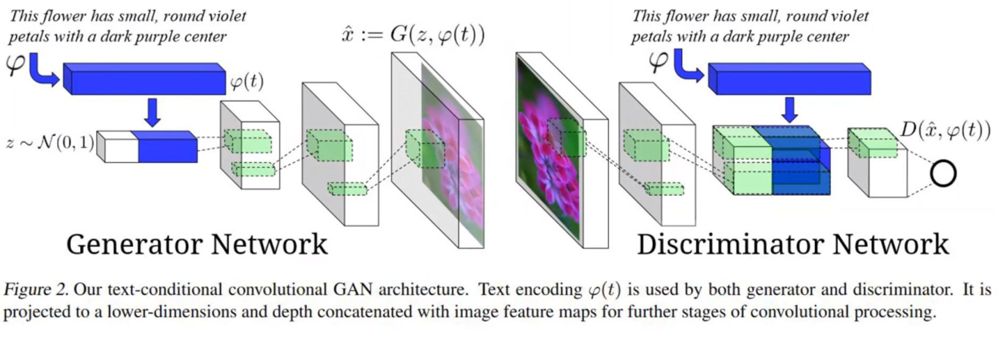


## Text-to-Image Synthesis: style encoder

During training also style encoder learns (it can restore style by image)

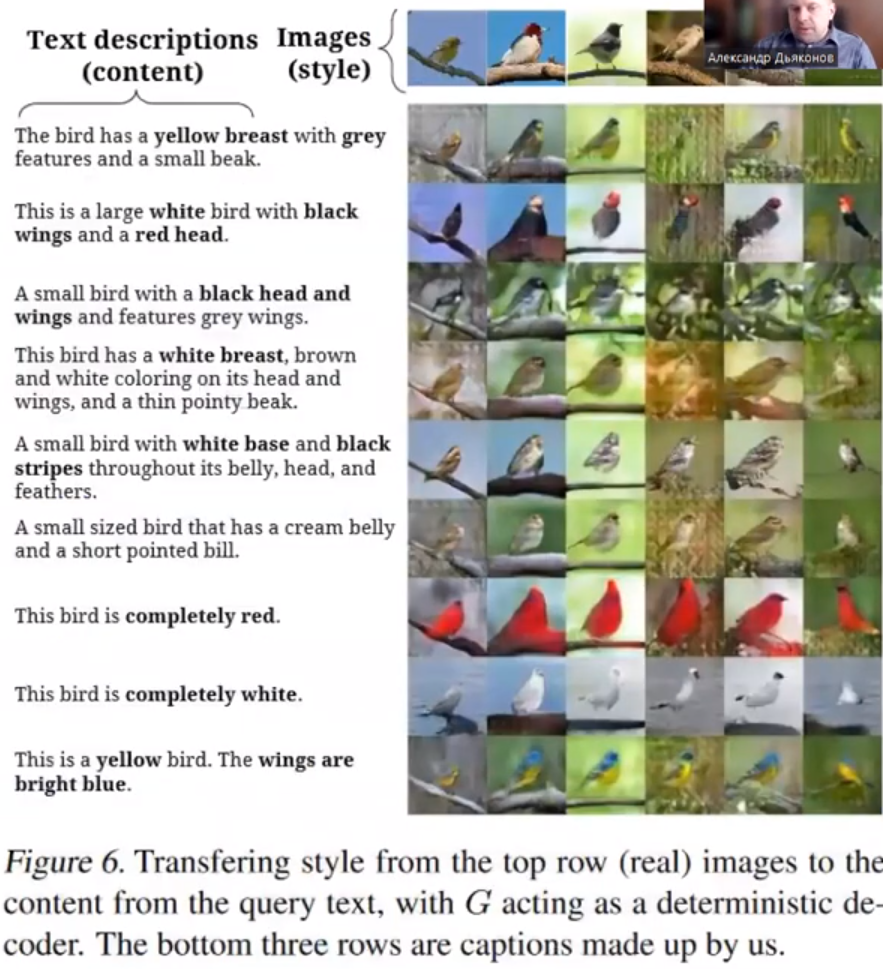

# StackGAN: text -> image

Main idea: multi-stage image generation

- Stage-I: raw image with low resolution, primitive forms and colors
- Stage-II: final image
- use Condititoning Augmentation: add noise to text embeddings (only for Generators)

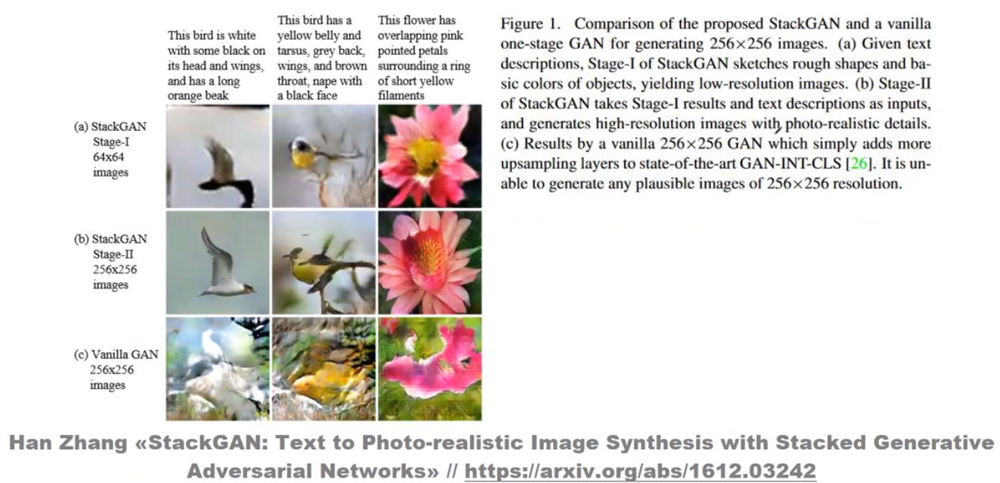

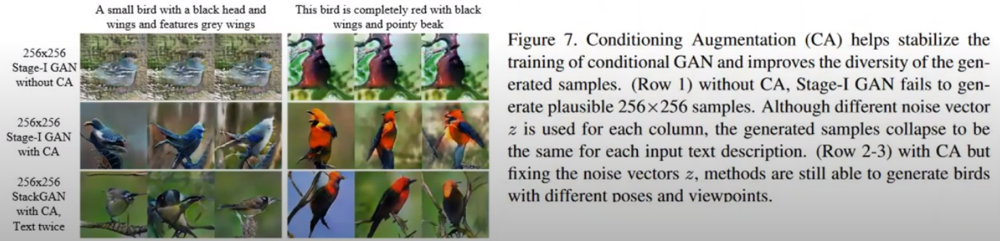

## StackGAN: architechture

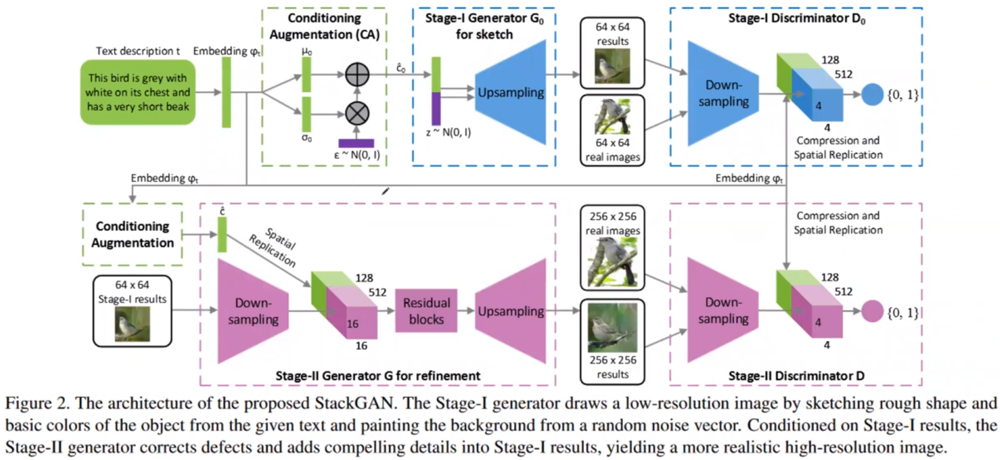

# GAN: Image-to-Image Translation

Task: translate one image to another (e.g. translate cat image to dog image)

# Multimodal Unsupervised Image-to-Image Translation (MUNIT)

Main idea: 
- images in each domain X<sub>i</sub> are encoded to a shared content space C and a domain-specific style space S<sub>i</sub>
- to translate image in X<sub>1</sub> to X<sub>2</sub> we recombine content code of the input with a style code in the target style space

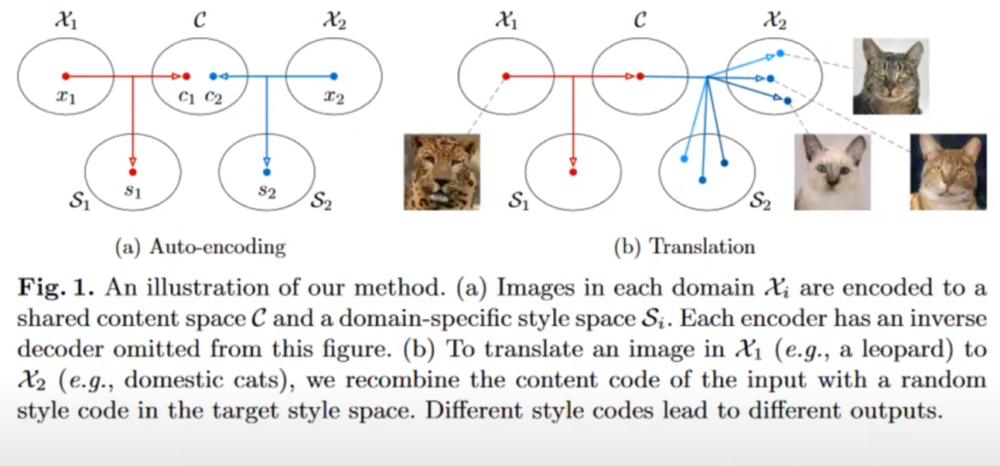

## MUNIT: loss functions

- during Within Domain Reconstruction generator must restore image
- during Cross Domain Translation generator must create new image and restore shared content C and style space S<sub>i</sub>

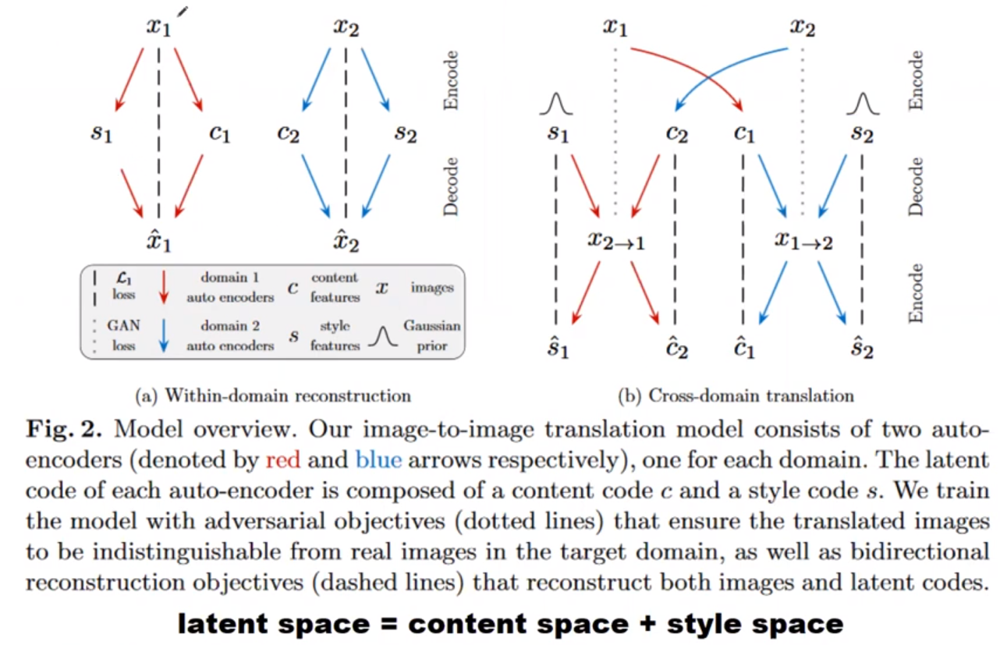


## MUNIT: architechture

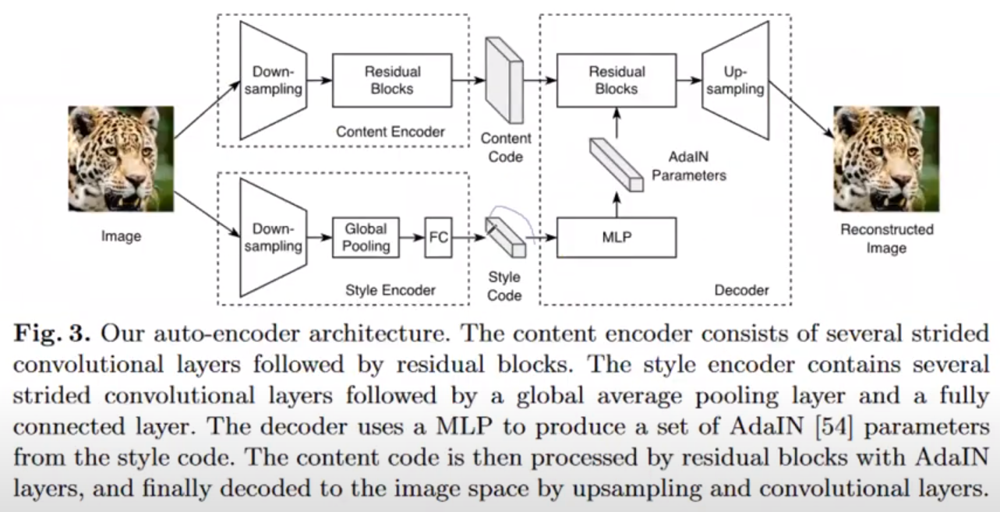


## MUNIT: result

Can take content from one image and style from another image and mix them together.

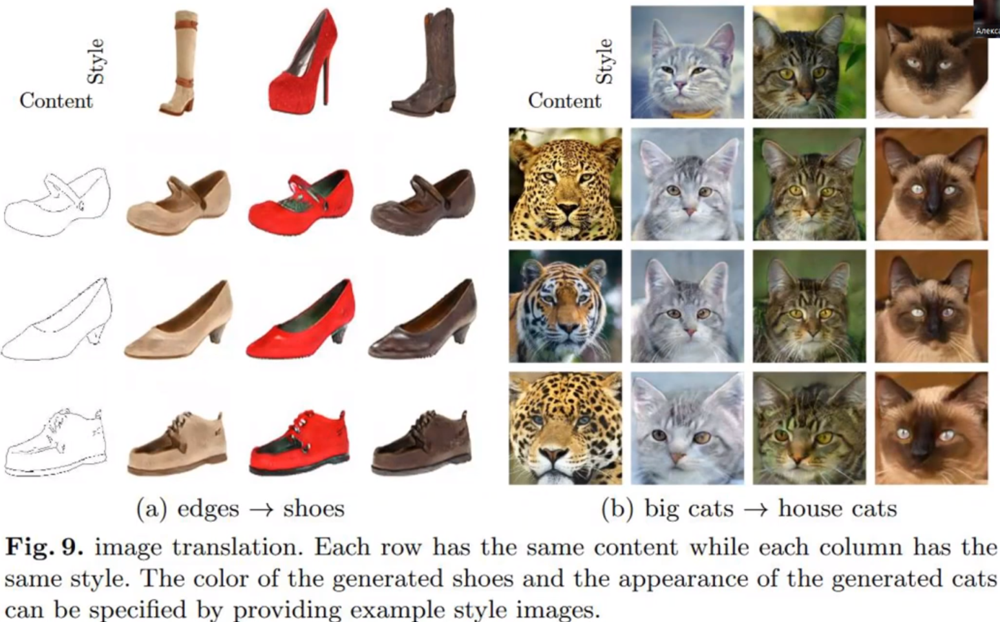

## Adaptive Instance Normalization (AdaIN)

**Instance Normalization**

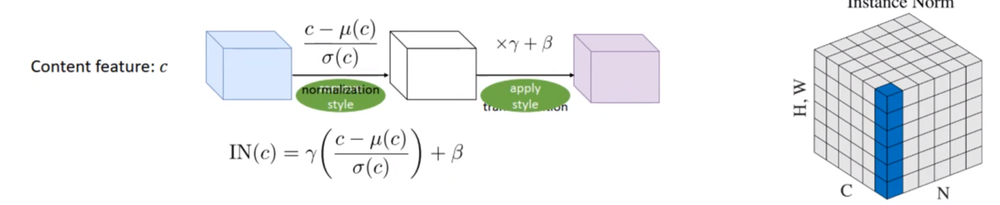

**Adaptive Instance Normalization**: parameters of back normalization (after Instance normalization) depend on style vector. 

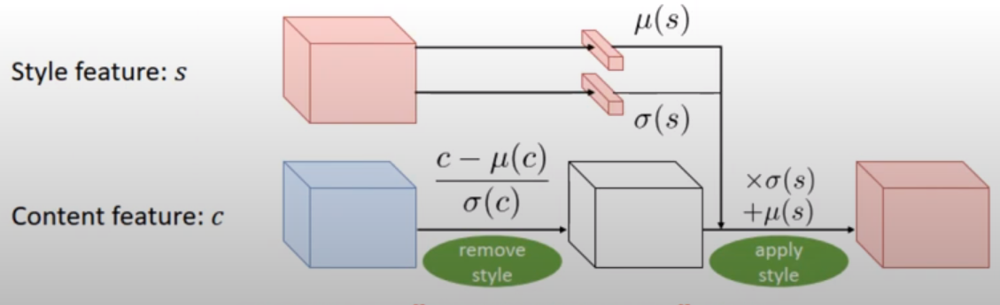

This works because style is encoded in some space-invariant statistics like channel mean / variance

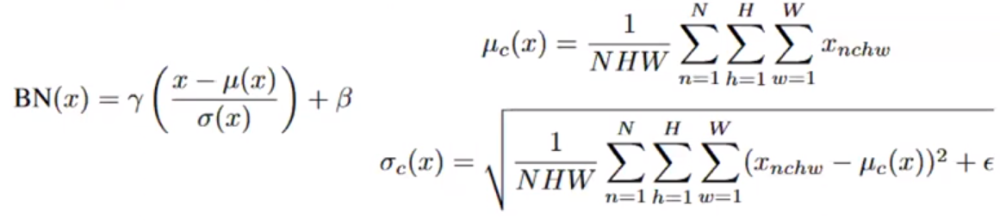

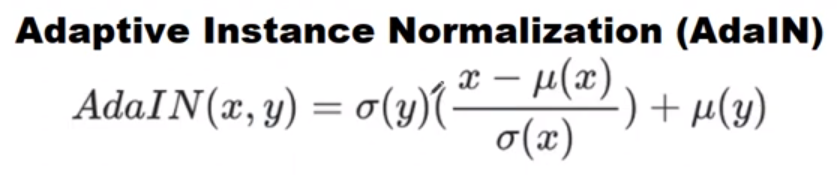

# Few-Shot Unsupervised Image-to-Image Translation (FUNIT)

Similar idea: change class of image but preserve it's content 

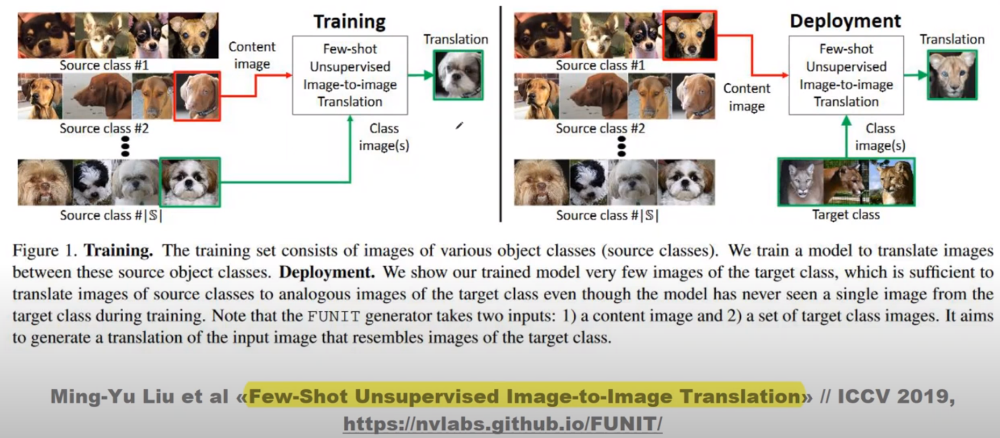


# FUNIT: architechture

- get content vector from content image
- class vector is average of all image vectors of this class
- use AdaIN (described above) to change class of content vector

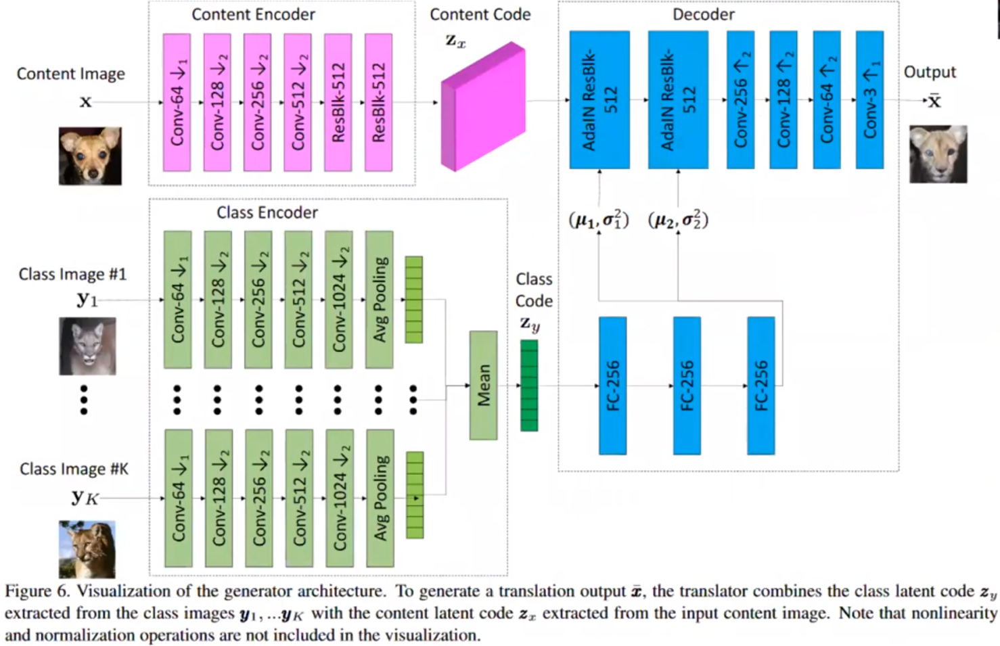



# StyleGAN

Main idea:

- map the input of generator to an intermediate latent space W, which then controls the generator through AdaIN at each convolution layer
- add noise before AdaIN to add diversity to generation results
- gradually increase resolution
- mixing regularization (style mixing): generate 2 style vectors z<sub>1</sub>, z<sub>2</sub> -> w<sub>1</sub>, w<sub>1</sub>; apply z<sub>1</sub> to all AdaIN layers before some selected point and apply z<sub>2</sub> to all AdaIn layers after this selected point; this trick let us mix styles safely (e.g. for small details one style will be used and for big details will be used another style)

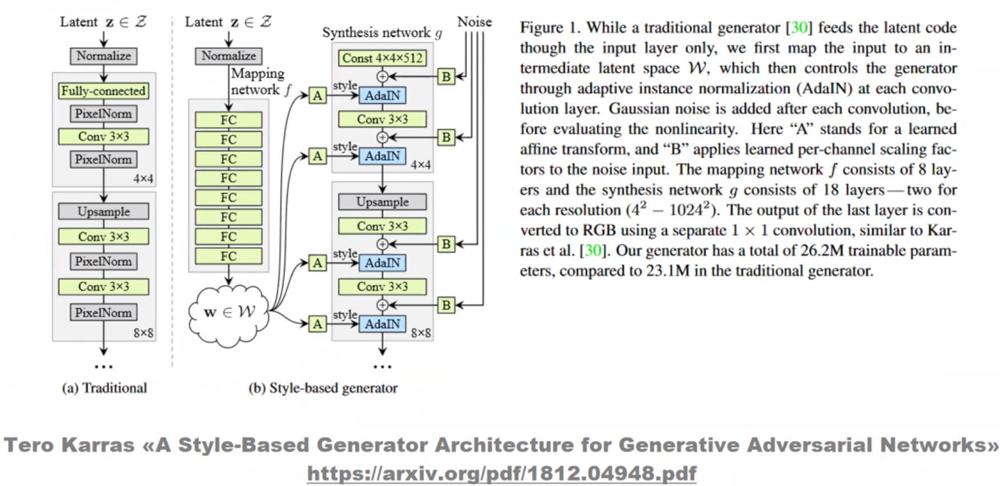

## StyleGAN: architechture

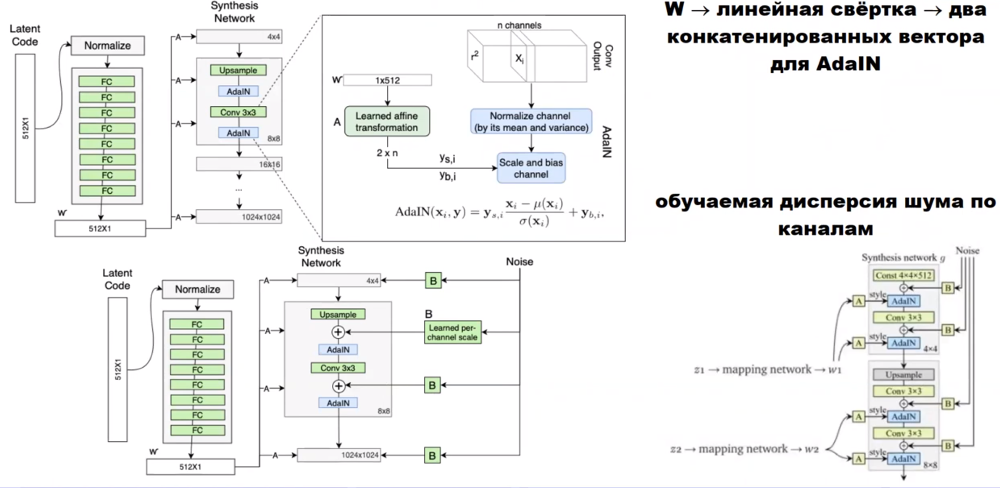

## StyleGAN: result

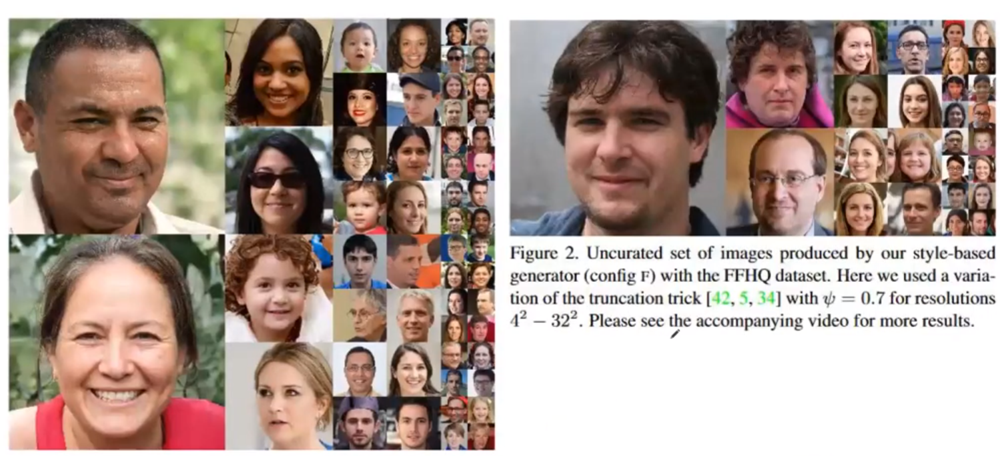

# StyleGAN: adding noise

Noise influences on small details on pictures (more noise -> more details).

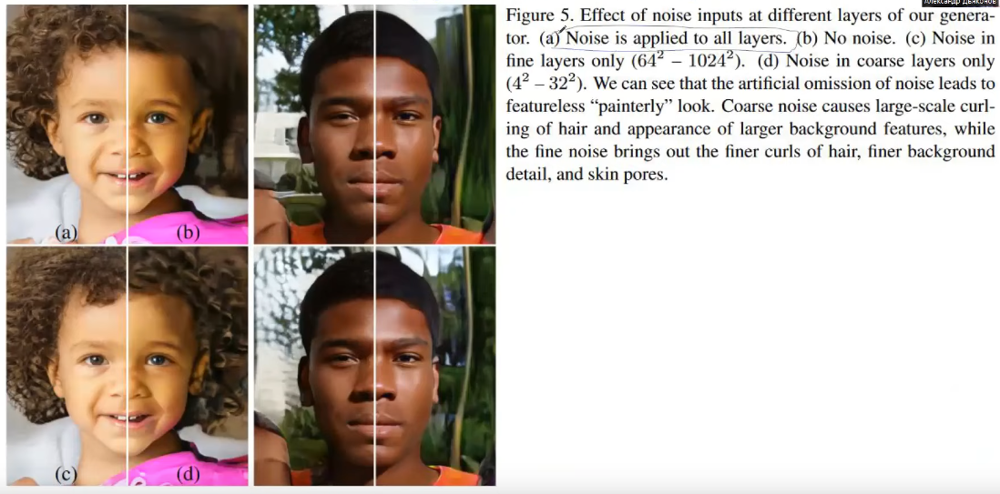](attachment:image.png)

# StyleGAN: disentangle representation

Main idea: each component of vector must influence on one feature (pose, haircut, eyes, etc). One of ways to this - make vector components orthogonal to each other.

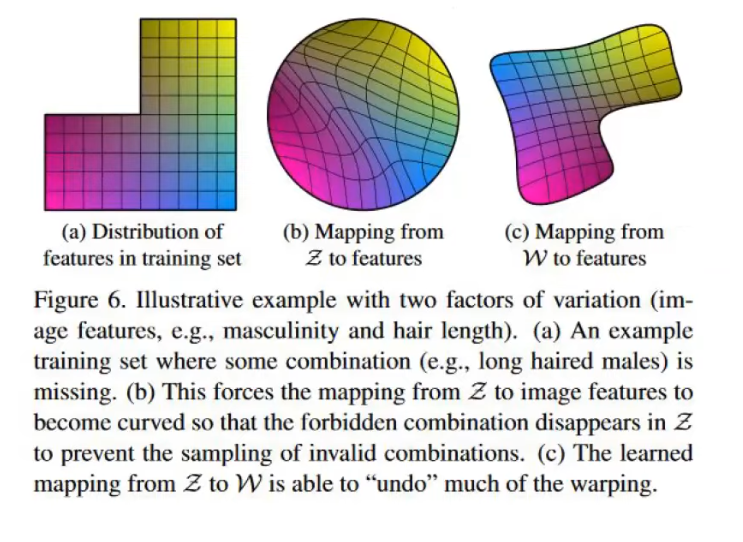

# StyleGAN2

## StyleGAN2: architechture

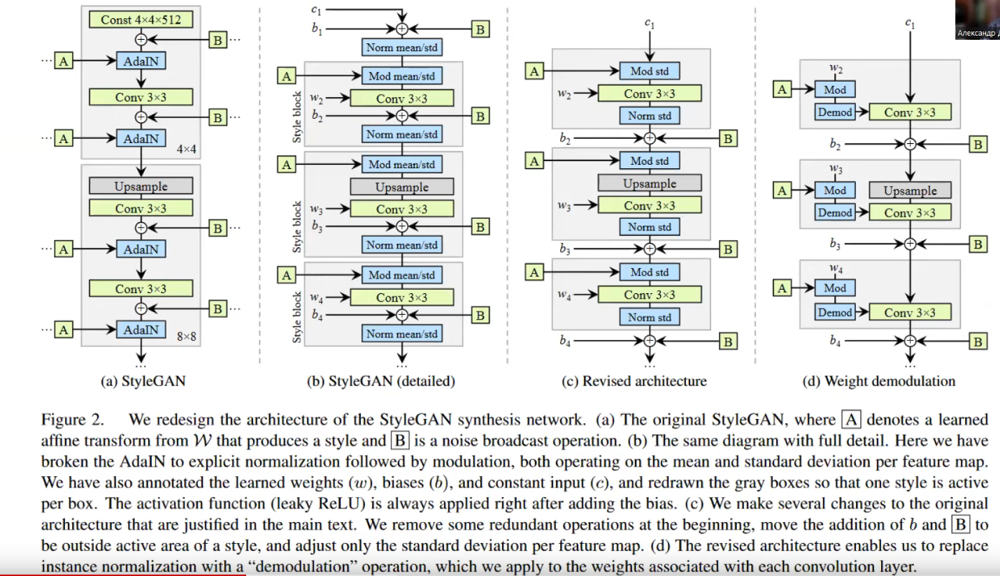

## StyleGAN2: weight demodulation

Main idea: stylization influences only on convolution layer - each conv layer gets it's own scale

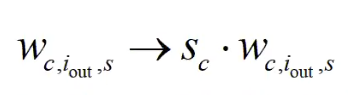

Where w<sub>c,i_out,s</sub> - conv weight, s<sub>c</sub> - scale factor of size H x W

Then we demodulate:

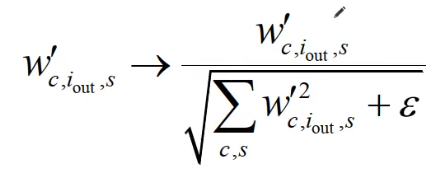

So stilization changes scales of different features and then normalize them back with the weight demodulation.

## StyleGAN2: lazy regularization

Main idea: consider regularization term only for each 16th batch.

## StyleGAN2: result

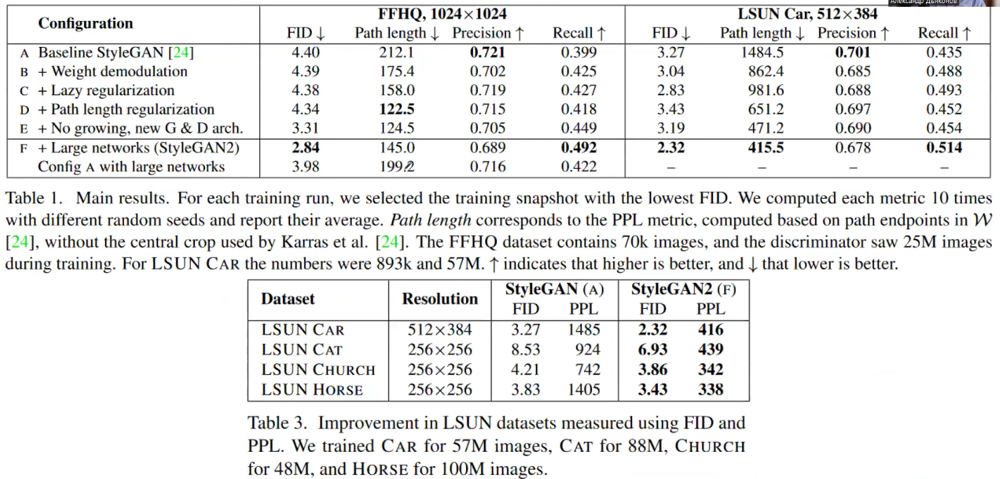

## StyleGAN2: adaptive discriminator augmentation

To train modern GAN in high resolution we need 10**5-10**6 pictures. Otherwise discriminator overfits on small dataset. Classic approach - augmentation - doesn't fit because generator will generate augmented pictures. 

## Balanced consistency regularization (bCR)

Main idea: augmentation must not change the answer of discriminator

## StyleGAN2: Adaptive discriminator augmentation

Main idea: augmentation is made for both generated image and true image. And generator must distinguish them. Also this augmentation is made with some probability.

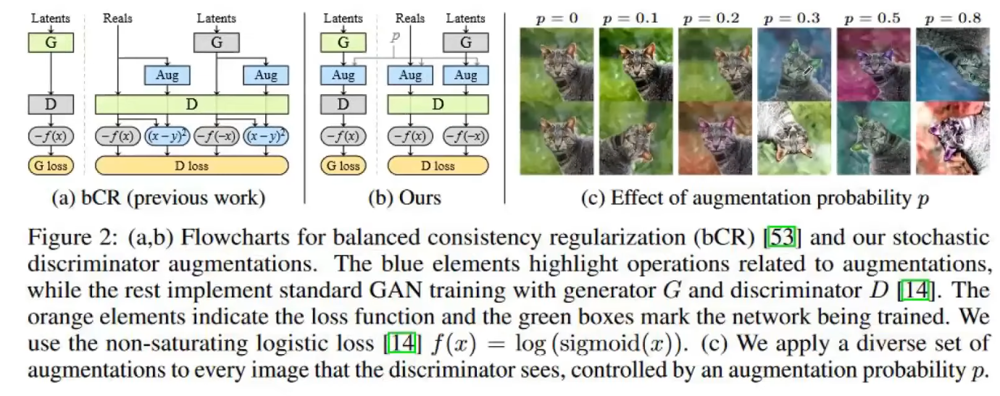



# Adversarial Autoencoders (AAE)

Main idea: VAE + Discriminator. Main advantage: we only need some distribution to sample from it, it must not be simple.

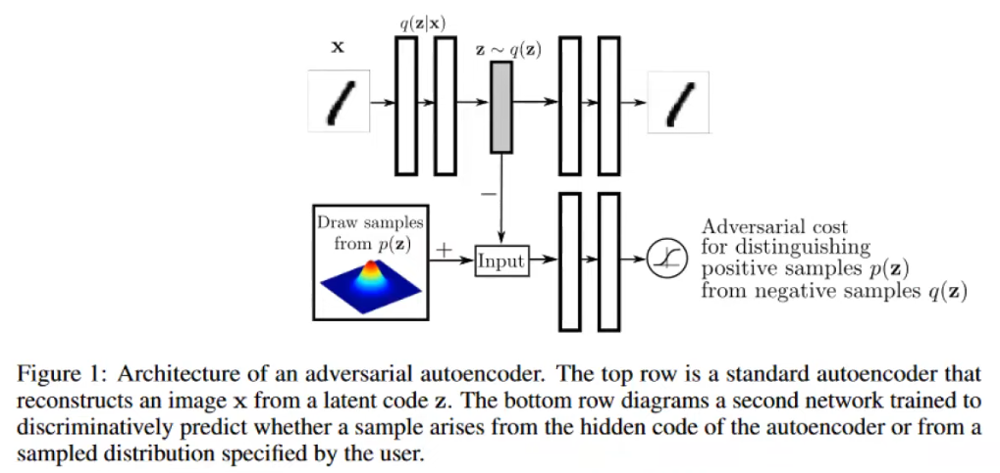

## AAE vs VAE

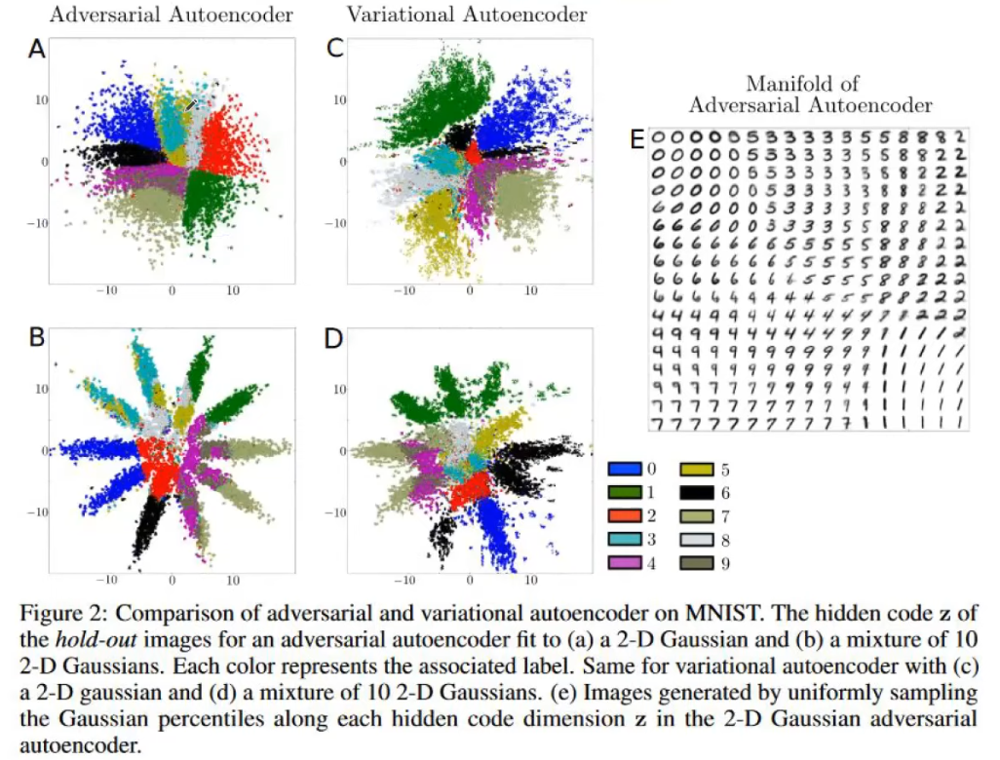

## VAE + labeled discriminator

Generation can be improved by sending class label to discriminator

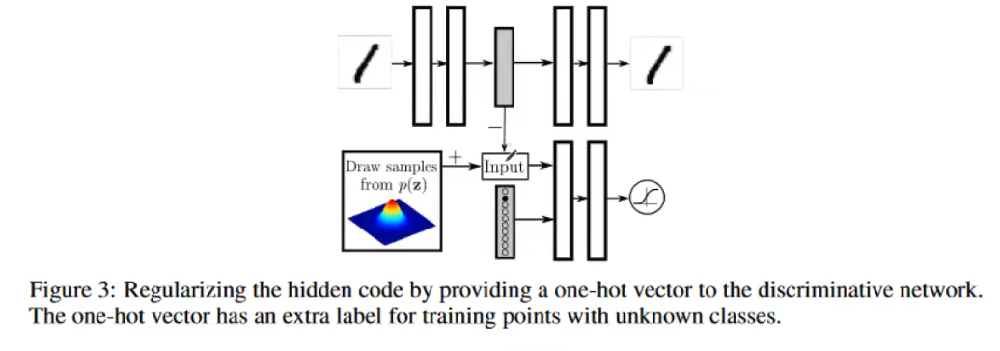

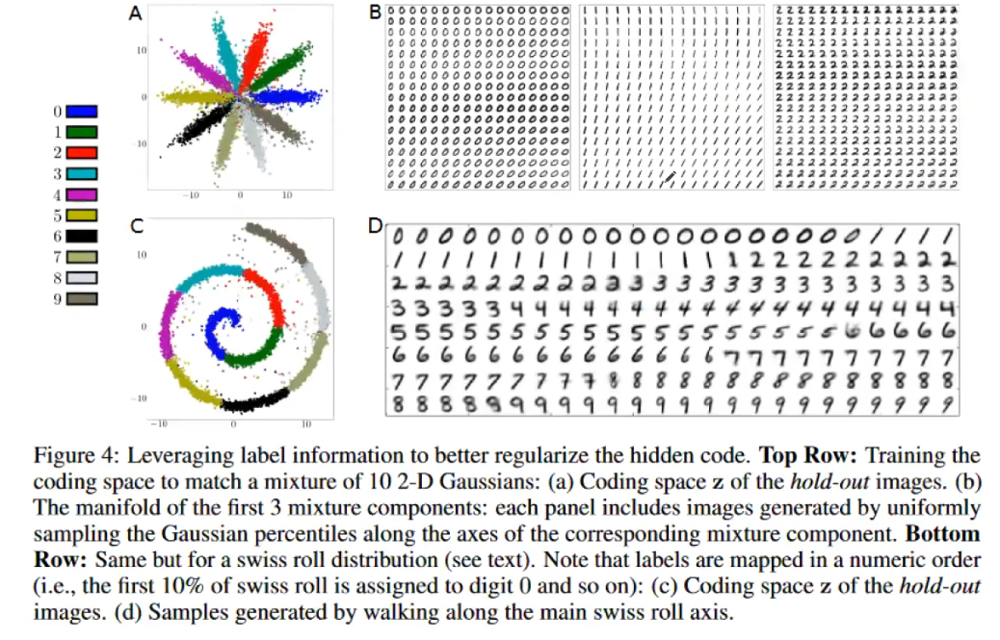
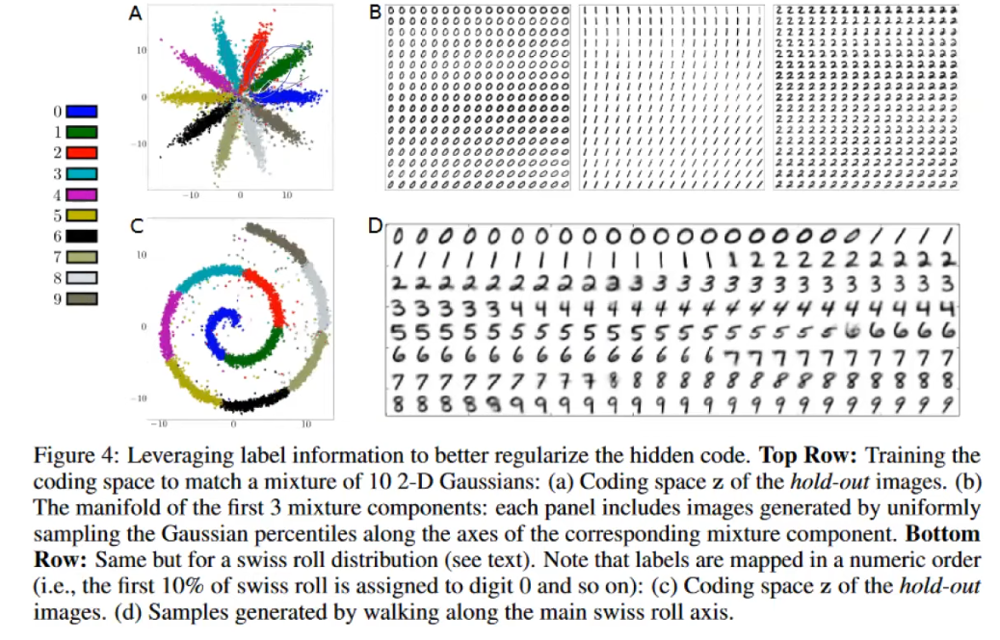

# Image generation benchmarks

## CIFAR-10

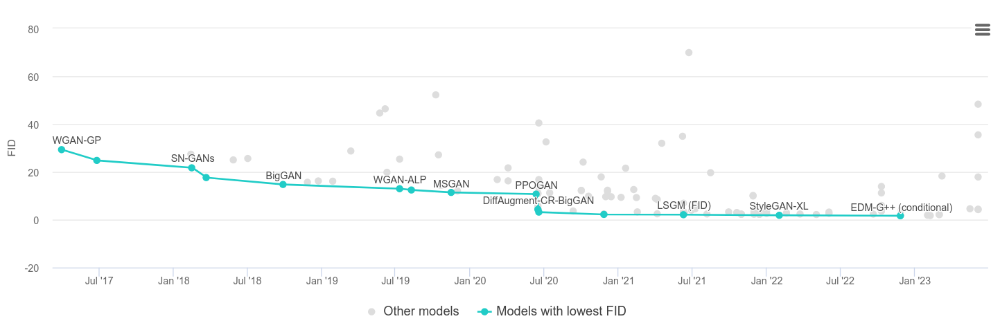

# Generative models conclusion

## Autoregressive models

Pro:
+ good at video, audio, images and text
+ explicit density specification

Contra:
- no interpolation (between two images)
- very slow
- no good latent representation
- ineffective serial generation

## Flows

Pro:

+ can be used with different methods
+ beautiful mathematics
+ reversible conversion
+ easy to sample/assess p(x)

Contra:

- latent space is huge (the same as original)

## VAE

Pro:
+ useful representation through hidden variables
+ compressed representation learning

Contra:
- blurry images
- inadequate latent space restrictions are possible
- not good for big images

## GAN:

Pro:

+ game approach
+ overfit resistant
+ generates one of the best clear images and do it fast
+ good condition models

Contra:

- no density estimation during training
- need some tricks to train well
- no good theoretic base
- mode collapse

## Diffusion models:

Pro:

+ generates images with the best quality (2023)

Contra:

- slow
